<center><h1> Case Study 5</h1></center>
<center><h3> Week 5 (out of 5)</h3></center>

**Author(s):**
1. Belicia Rodriguez (belicia.rodriguez@emory.edu)
 
**Data Source**: W.C. Hunter and M.B. Walker (1996), [“*The Cultural Affinity Hypothesis and Mortgage Lending Decisions*,”](https://link.springer.com/article/10.1007/BF00174551) Journal of Real Estate Finance and Economics 13, 57-70.
 
**Book**: [Introductory Econometrics: A Modern Approach](https://economics.ut.ac.ir/documents/3030266/14100645/Jeffrey_M._Wooldridge_Introductory_Econometrics_A_Modern_Approach__2012.pdf) by Jeffrey Wooldridge

**Data Description**: ```http://fmwww.bc.edu/ec-p/data/wooldridge/loanapp.dta```

```
  Obs:  1989

  1. occ                       occupancy
  2. loanamt                   loan amt in thousands
  3. action                    type of action taken
  4. msa                       msa number of property
  5. suffolk                   =1 if property in Suffolk County
  6. race                      race of applicant
  7. gender                    gender of applicant
  8. appinc                    applicant income, $1000s
  9. typur                     type of purchaser of loan
 10. unit                      number of units in property
 11. married                   =1 if applicant married
 12. dep                       number of dependents
 13. emp                       years employed in line of work
 14. yjob                      years at this job
 15. self                      self-employment dummy
 16. atotinc                   total monthly income
 17. cototinc                  coapp total monthly income
 18. hexp                      propose housing expense
 19. price                     purchase price
 20. other                     other financing, $1000s
 21. liq                       liquid assets
 22. rep                       no. of credit reports
 23. gdlin                     credit history meets guidelines
 24. lines                     no. of credit lines on reports
 25. mortg                     credit history on mortgage paym
 26. cons                      credit history on consumer stuf
 27. pubrec                    =1 if filed bankruptcy
 28. hrat                      housing exp, % total inccome
 29. obrat                     other oblgs,  % total income
 30. fixadj                    fixed or adjustable rate?
 31. term                      term of loan in months
 32. apr                       appraised value
 33. prop                      type of property
 34. inss                      PMI sought
 35. inson                     PMI approved
 36. gift                      gift as down payment
 37. cosign                    is there a cosigner
 38. unver                     unverifiable info
 39. review                    number of times reviewed
 40. netw                      net worth
 41. unem                      unemployment rate by industry
 42. min30                     =1 if minority pop. > 30%
 43. bd                        =1 if boarded-up val > MSA med
 44. mi                        =1 if tract inc > MSA median
 45. old                       =1 if applic age > MSA median
 46. vr                        =1 if tract vac rte > MSA med
 47. sch                       =1 if > 12 years schooling
 48. black                     =1 if applicant black
 49. hispan                    =1 if applicant Hispanic
 50. male                      =1 if applicant male
 51. reject                    =1 if action == 3
 52. approve                   =1 if action == 1 or 2
 53. mortno                    no mortgage history
 54. mortperf                  no late mort. payments
 55. mortlat1                  one or two late payments
 56. mortlat2                  > 2 late payments
 57. chist                     =0 if accnts deliq. >= 60 days
 58. multi                     =1 if two or more units
 59. loanprc                   amt/price
 60. thick                     =1 if rep > 2
 61. white                     =1 if applicant white
 62. obwhte                    obrat*awhite
 ```

1. You are interested in building a model that accurately predict loan rejection (`rejection`) based on various applicants' features such as `loanamt`, `appinc`, `unit`, `married`, `dep`, `emp`, `yjob`, `self`, `atotinc`, `cototinc`, `hexp`, `price`, `other`, `liq`, `rep`, `gdlin`, `lines`, `mortg`, `cons`, `pubrec`, `hrat`, `obrat`, `fixadj`, `term`, `apr`, `gift`, `cosign`, `netw`, `uem`, `min30`, `bd`, `mi`, `old`, `vr`, `sch`, `mortno`, `chist`, `multi`, `loanprc`, `thick`, and the `race`, and `gender` characteristics.
    1. [10 points] For _all_ the proposed features measured in USD that contain __negative__ values, proceed to replace these negative values with zeroes. Leave the _original_ zeroes in them as such.
    2. [10 points] Build a single _decision tree_ based on these features using a [random_state](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html) equal to 42, using 75% of the original data set as your train set (use 42 again as your random seed).
    3. [10 points] Which [criterion](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html) produce a better score?

In [1]:
import pandas as pd
import numpy as np
import patsy
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

# import dataset
loanapp = pd.read_stata('http://fmwww.bc.edu/ec-p/data/wooldridge/loanapp.dta')

# list all proposed features
features = ['loanamt', 'appinc', 'unit', 'married', 'dep', 'emp', 'yjob', 'self', 'atotinc', 'cototinc', 'hexp', 'price', 'other', 'liq', 'rep', 'gdlin', 'lines', 'mortg', 'cons', 'pubrec', 'hrat', 'obrat', 'fixadj', 'term', 'apr', 'gift', 'cosign', 'netw', 'unem', 'min30', 'bd', 'mi', 'old', 'vr', 'sch', 'mortno', 'chist', 'multi', 'loanprc', 'thick', 'race', 'gender']

# list of proposed features in USD
usd_features = ['loanamt', 'appinc', 'atotinc', 'cototinc', 'hexp', 'price', 'other', 'liq', 'apr', 'netw', 'loanprc']

# replace negative values in usd_features with zero
for i in usd_features:
    loanapp[i].loc[loanapp[i] < 0] = 0

# create a subset the loanapp dataframe that contains features and predictive variable
subloanapp = loanapp[features + ['reject']]
subloanapp.dropna(inplace=True)

# create dataframes containing features and predictive variable
X_reject = subloanapp[features]
y_reject = subloanapp[['reject']]

# split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_reject, y_reject, train_size=0.75, random_state=42)

# create decision tree object for gini and entropy criterias
dt_gini = DecisionTreeClassifier(criterion='gini', random_state=42)
dt_entropy = DecisionTreeClassifier(criterion='entropy', random_state=42)

# fit the models using training set
dt_gini.fit(X_train, y_train)
dt_entropy.fit(X_train, y_train)

# print scores of both models with different criteria
gini_score = dt_gini.score(X_test, y_test)
print('Gini Decision Tree Score:', round(gini_score, 6))

entropy_score = dt_entropy.score(X_test, y_test)
print('Entropy Decision Tree Score:', round(entropy_score, 6))

print()
print('Gini produced a better score.')

Gini Decision Tree Score: 0.895323
Entropy Decision Tree Score: 0.868597

Gini produced a better score.


2. [20 points] Now perform the same analysis as in question 1 above _but_ use the `action` variable as your outcome variable, and produce a color graph of the confusion matrix based on your test data set as shown in the instructional video using the [criterion](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html) that produced the best score.

Gini Decision Tree Score: 0.830735
Entropy Decision Tree Score: 0.824053


Text(0.5, 1, 'Decision Tree Entropy Confusion Matrix')

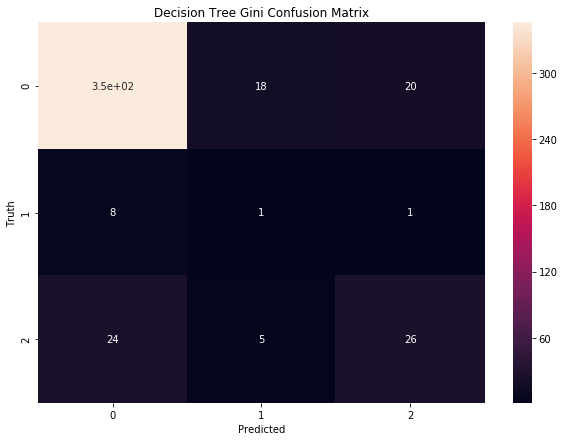

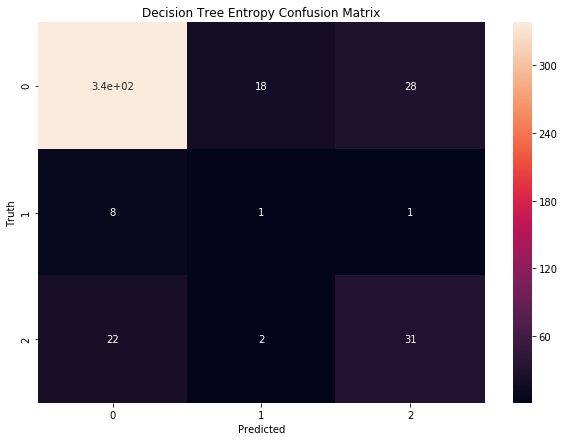

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sn
from sklearn.metrics import confusion_matrix

# create a subset the loanapp dataframe that contains features and predictive variable
subloanapp = loanapp[features + ['action']]
subloanapp.dropna(inplace=True)

# create dataframe containing features and predictive variable
X_action = subloanapp[features]
y_action = subloanapp[['action']]

# split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_action, y_action, train_size=0.75, random_state=42)

# create decision tree object for gini and entropy criterias
dt_gini = DecisionTreeClassifier(criterion='gini', random_state=42)
dt_entropy = DecisionTreeClassifier(criterion='entropy', random_state=42)

# fit the models using training set
dt_gini.fit(X_train, y_train)
dt_entropy.fit(X_train, y_train)

# print scores of both models with different criteria
gini_score = dt_gini.score(X_test, y_test)
print('Gini Decision Tree Score:', round(gini_score, 6))

entropy_score = dt_entropy.score(X_test, y_test)
print('Entropy Decision Tree Score:', round(entropy_score, 6))

# GINI CONFUSION MATRIX
# predict y values from X test set
y_predicted = dt_gini.predict(X_test)

# create confusion matrix
cm_gini = confusion_matrix(y_test, y_predicted)

# produce color map of confusion matrix
plt.figure(figsize=(10,7))
sn.heatmap(cm_gini, annot=True)
plt.ylim(len(cm_gini), 0)
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Decision Tree Gini Confusion Matrix')

# ENTROPY CONFUSION MATRIX
# predict y values from X test set
y_predicted = dt_entropy.predict(X_test)

# create confusion matrix
cm_entropy = confusion_matrix(y_test, y_predicted)

# produce color map of confusion matrix
plt.figure(figsize=(10,7))
sn.heatmap(cm_entropy, annot=True)
plt.ylim(len(cm_gini), 0)
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Decision Tree Entropy Confusion Matrix')

3. [30 points] Now redo your answers to questions 1 and 2 (using the `gini` criterion) above but implementing a Random Forest (with options `n_estimators=50` and `random_state=42`). __Note__: Please read the relevant [documentation](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html) if you were to find numerical issues.

Question 1 - 
Random Forest Score w/ reject dependent variable: 0.928731

Question 2 - 
Random Forest Score w/ action dependent variable: 0.908686


Text(0.5, 1, 'Random Forest Gini Confusion Matrix w/ action Dependent Variable')

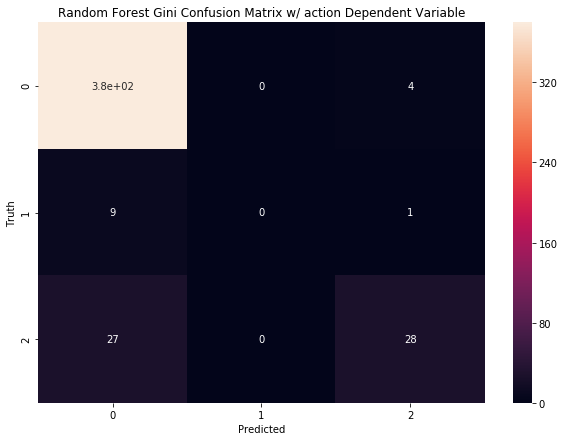

In [3]:
from sklearn.ensemble import RandomForestClassifier

# create random forest object
rf_reject = RandomForestClassifier(criterion='gini', n_estimators=50, random_state=42)
rf_action = RandomForestClassifier(criterion='gini', n_estimators=50, random_state=42)

# QUESTION 1:
# split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_reject, y_reject, train_size=0.75, random_state=42)

# fit the models using training set
rf_reject.fit(X_train, y_train)

# print scores
rf_score = rf_reject.score(X_test, y_test)
print('Question 1 - \nRandom Forest Score w/ reject dependent variable:', round(rf_score, 6))

# QUESTION 2:
# split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_action, y_action, train_size=0.75, random_state=42)

# fit the models using training set
rf_action.fit(X_train, y_train)

# print scores
rf_score = rf_action.score(X_test, y_test)
print('\nQuestion 2 - \nRandom Forest Score w/ action dependent variable:', round(rf_score, 6))

# predict y values from X test set
y_predicted = rf_action.predict(X_test)

# create confusion matrix
cm_gini = confusion_matrix(y_test, y_predicted)

# produce color map of confusion matrix
plt.figure(figsize=(10,7))
sn.heatmap(cm_gini, annot=True)
plt.ylim(len(cm_gini), 0)
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Random Forest Gini Confusion Matrix w/ action Dependent Variable')

4. [20 points] After reading this [post](https://towardsdatascience.com/how-to-visualize-a-decision-tree-from-a-random-forest-in-python-using-scikit-learn-38ad2d75f21c) and watching this [video](https://www.youtube.com/watch?v=SMGEmCOUBUw), proceed to plot the resulting graphs for the 5th, 23rd, and 47th estimators in your random forest implementation in question 3 above when you use the `rejection` decision as your outcome variable.

In [4]:
from sklearn.tree import export_graphviz
from subprocess import call
from IPython.display import Image

# extract 5th estimator
estimator_5 = rf_reject.estimators_[4]

# Export as dot file
export_graphviz(estimator_5, out_file='tree.dot', rounded = True, proportion = False, precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# display tree image
Image(filename = 'tree.png')

In [5]:
# extract 23rd tree
estimator_23 = rf_reject.estimators_[22]

# Export as dot file
export_graphviz(estimator_23, out_file='tree23.dot', rounded = True, proportion = False, precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
call(['dot', '-Tpng', 'tree23.dot', '-o', 'tree23.png', '-Gdpi=600'])

# display tree image
Image(filename = 'tree23.png')

In [6]:
# extract 47th estimator
estimator_47 = rf_reject.estimators_[46]

# Export as dot file
export_graphviz(estimator_47, out_file='tree47.dot', rounded = True, proportion = False, precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
call(['dot', '-Tpng', 'tree47.dot', '-o', 'tree47.png', '-Gdpi=600'])

# display tree image
Image(filename = 'tree47.png')